In [21]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/style-transfer-dt/style.jpg
/kaggle/input/style-transfer-dt/content.jpg


In [22]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.models as models
from PIL import Image
import matplotlib.pyplot as plt
import copy

In [23]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [24]:
models.vgg19(pretrained=True).features

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

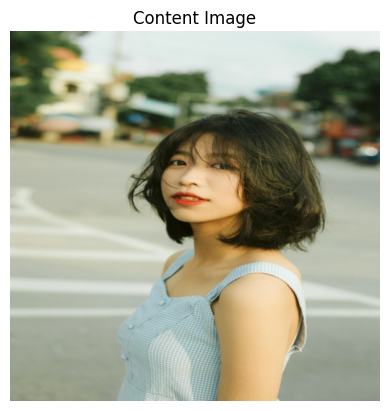

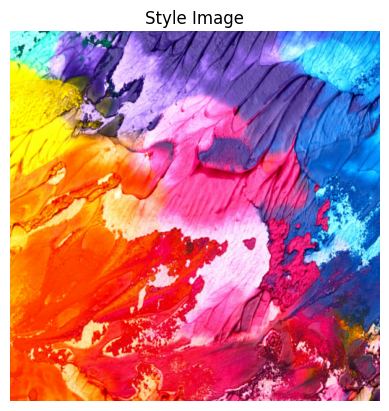

In [5]:
# img loader and unloader

fixed_imsize = 512 

prep_img = transforms.Compose([
    transforms.Resize((fixed_imsize, fixed_imsize)),
    transforms.ToTensor(), 
    transforms.Lambda(lambda x: x[:3, :, :]), 
    transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                         std=[0.229, 0.224, 0.225])
])

def img_ldr(path):
    image = Image.open(path).convert("RGB")
    image = prep_img(image).unsqueeze(0)
    return image.to(device, torch.float)

# this reversers the normalization applied during img loading

unloader = transforms.Compose([
    transforms.Normalize(mean=[-2.12, -2.04, -1.80],
                         std=[4.37, 4.46, 4.44]),
    transforms.ToPILImage()
])

style_image = img_ldr("/kaggle/input/style-transfer-dt/style.jpg")
content_image = img_ldr("/kaggle/input/style-transfer-dt/content.jpg")


def imshow(tensor, title=None):
    image = tensor.cpu().clone().squeeze(0)
    image = unloader(image)
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.axis("off")
    plt.show()

imshow(content_image, title='Content Image')
imshow(style_image, title='Style Image')

In [6]:
vgg = models.vgg19(pretrained=True).features.to(device).eval()

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:02<00:00, 208MB/s] 


In [7]:
# Load pretrained VGG19 features (only convolutional part)
vgg = models.vgg19(pretrained=True).features.to(device).eval()

# We will store activations here
activations = {}

# Register hooks to each layer we want to visualize
def get_activation(name):
    def hook(model, input, output):
        activations[name] = output.detach()
    return hook

# Register hooks on all layers (or selective layers if you want)
for i, layer in enumerate(vgg):
    layer.register_forward_hook(get_activation(f'layer_{i}'))

# Forward pass content image
with torch.no_grad():
    vgg(content_image)

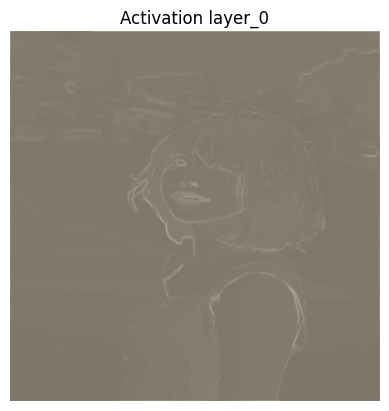

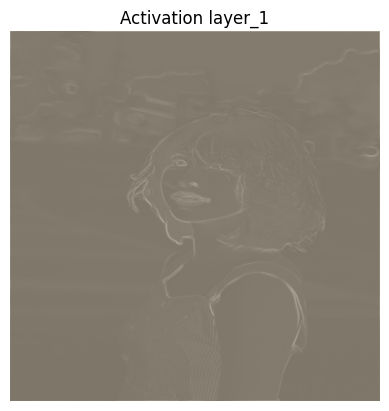

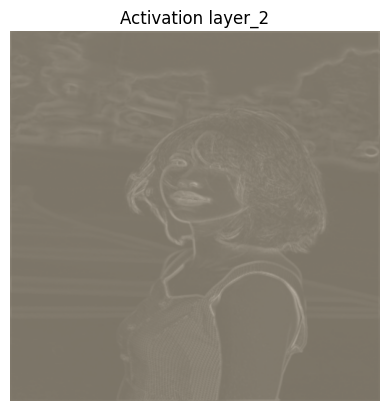

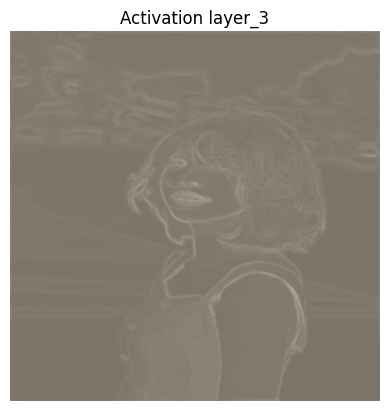

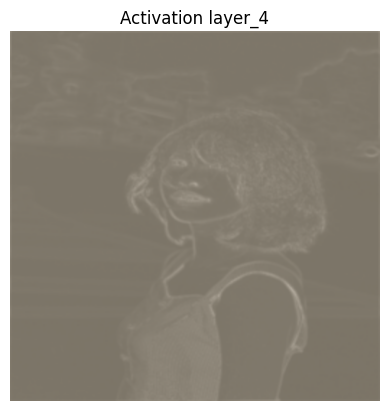

...

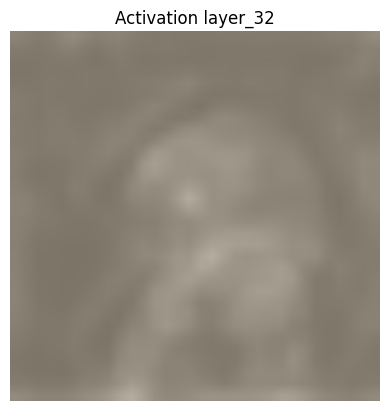

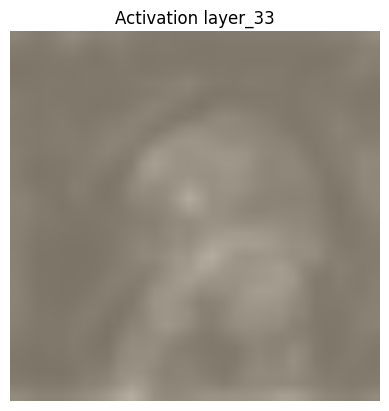

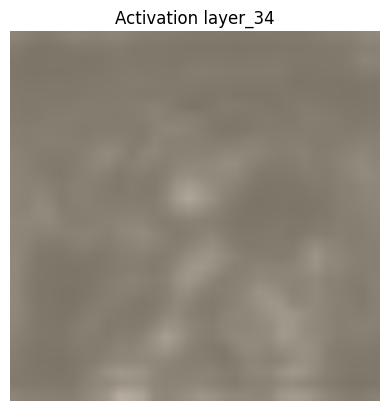

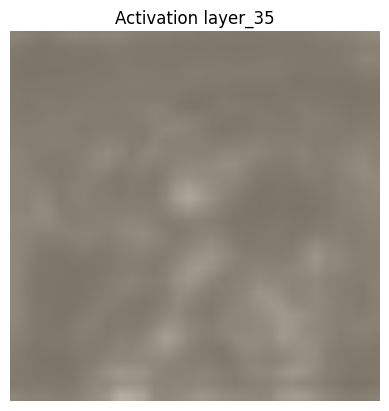

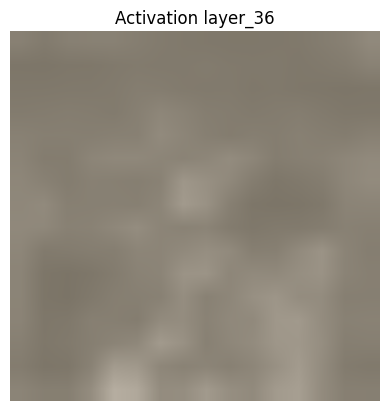

In [8]:

for name, act in activations.items():
    # act shape: [1, C, H, W]
    act_img = act.mean(dim=1, keepdim=True)
    
    # Normalize this tensor for visualization (0 to 1)
    min_val = act_img.min()
    max_val = act_img.max()
    act_img_norm = (act_img - min_val) / (max_val - min_val + 1e-5)
    
    # Resize to original image size (optional)
    act_img_norm = nn.functional.interpolate(act_img_norm, size=(fixed_imsize, fixed_imsize), mode='bilinear', align_corners=False)
    
    # Convert single channel to 3 channel by repeating
    act_img_rgb = act_img_norm.repeat(1,3,1,1)
    
    imshow(act_img_rgb, title=f'Activation {name}')



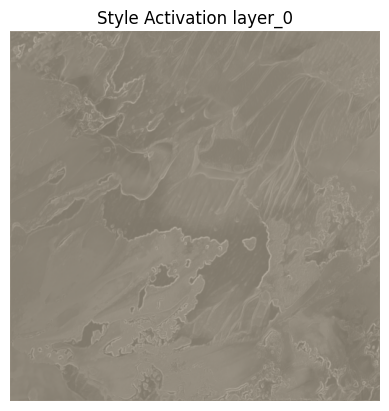

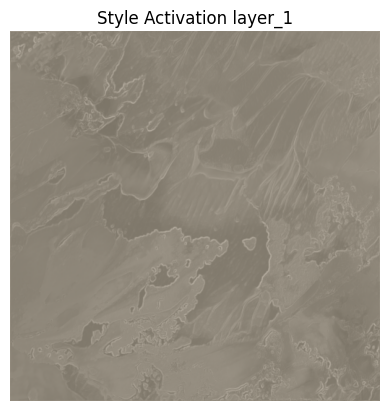

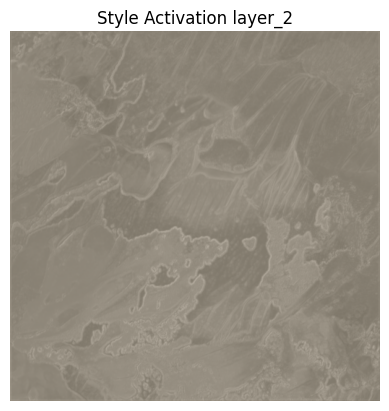

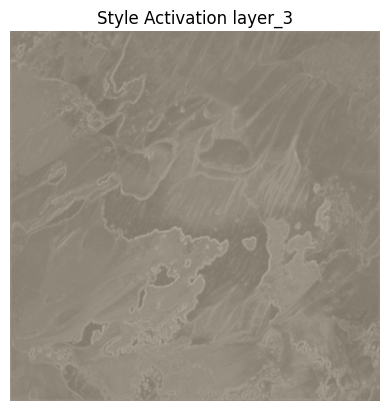

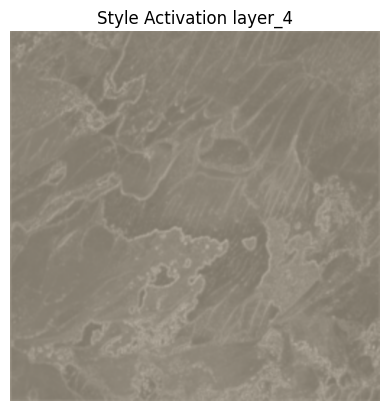

...

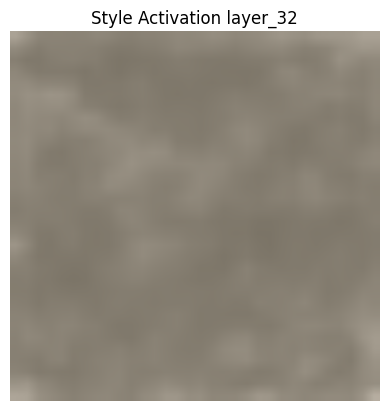

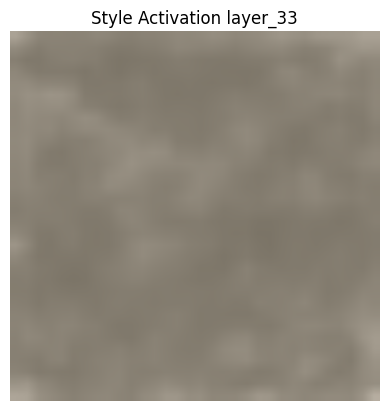

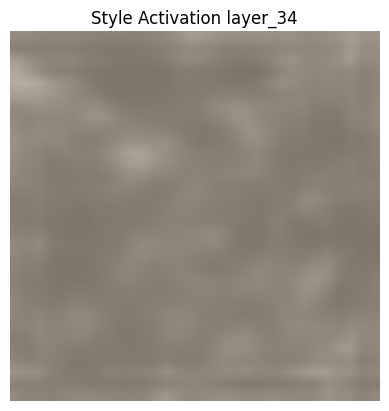

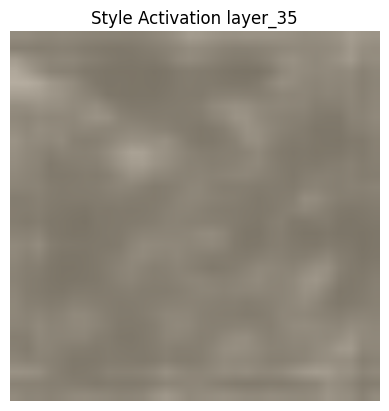

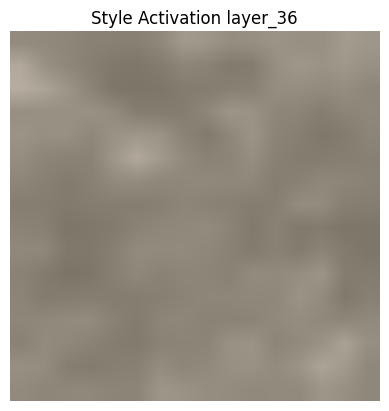

In [9]:
# Step 1: Clear previous activations
activations.clear()

# Step 2: Forward pass the style image
with torch.no_grad():
    vgg(style_image)

# Step 3: Visualize activations
for name, act in activations.items():
    act_img = act.mean(dim=1, keepdim=True)  # Average over channels → grayscale
    min_val = act_img.min()
    max_val = act_img.max()
    act_img_norm = (act_img - min_val) / (max_val - min_val + 1e-5)  # Normalize to 0–1

    # Resize and convert to fake RGB for display
    act_img_norm = nn.functional.interpolate(
        act_img_norm, size=(fixed_imsize, fixed_imsize), mode='bilinear', align_corners=False
    )
    act_img_rgb = act_img_norm.repeat(1, 3, 1, 1)

    imshow(act_img_rgb, title=f'Style Activation {name}')

In [10]:
selected_layers = {
    '0': 'conv1_1',
    '5': 'conv2_1',
    '10': 'conv3_1',
    '19': 'conv4_1',
    '28': 'conv5_1',
}


In [11]:
activations = {}

def get_activation(name):
    def hook(model, input, output):
        activations[name] = output.detach()
    return hook

for idx, layer in enumerate(vgg):
    if str(idx) in selected_layers:
        layer.register_forward_hook(get_activation(selected_layers[str(idx)]))


In [12]:
def visualize_activations(activations, image_type):
    for name, act in activations.items():
        act_img = act.mean(dim=1, keepdim=True)  # Average channels → grayscale
        min_val = act_img.min()
        max_val = act_img.max()
        act_img_norm = (act_img - min_val) / (max_val - min_val + 1e-5)
        act_img_norm = nn.functional.interpolate(act_img_norm, size=(fixed_imsize, fixed_imsize), mode='bilinear')
        act_img_rgb = act_img_norm.repeat(1, 3, 1, 1)
        imshow(act_img_rgb, title=f'{image_type} Activation: {name}')


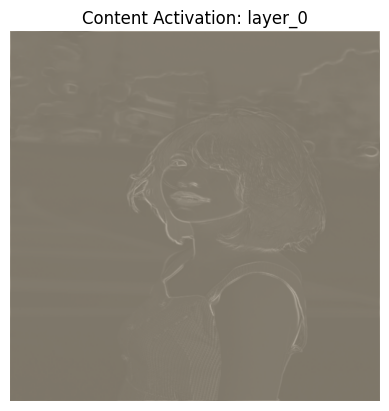

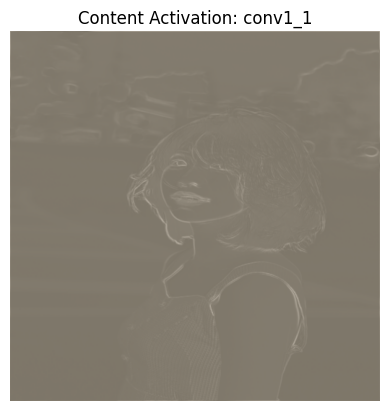

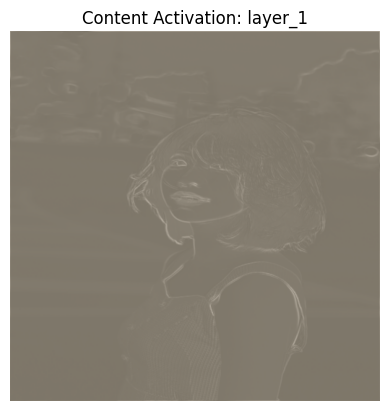

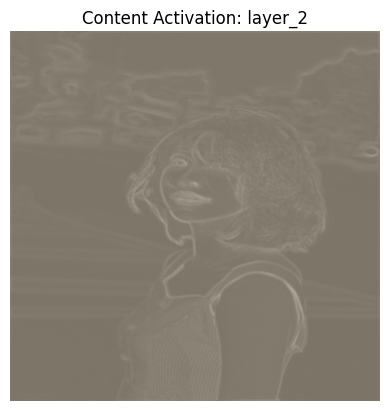

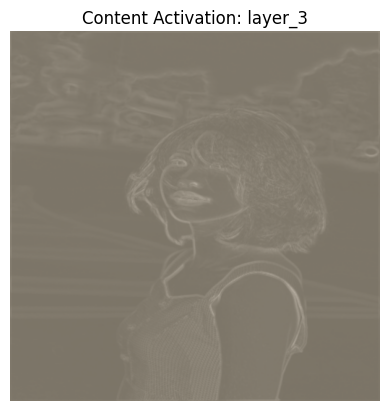

...

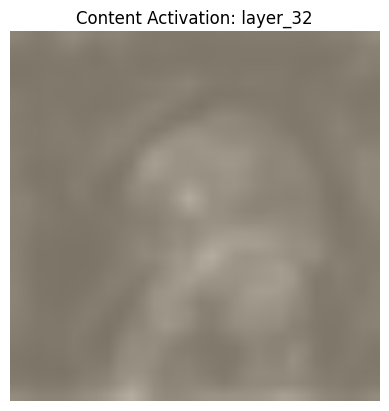

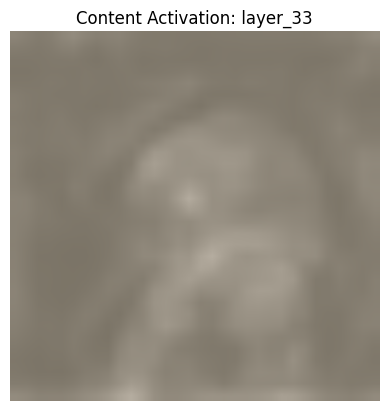

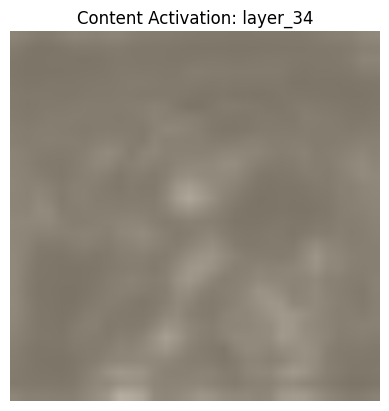

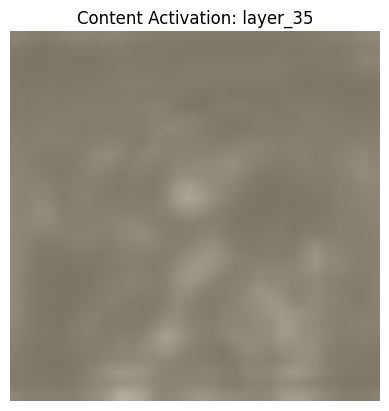

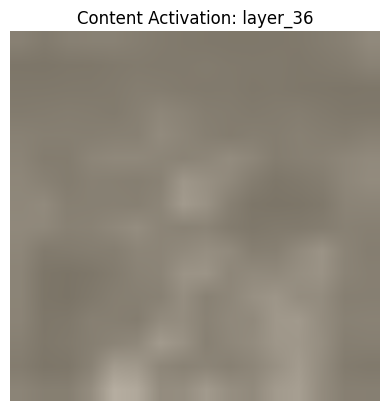

In [13]:
activations.clear()
with torch.no_grad():
    vgg(content_image)

visualize_activations(activations, 'Content')


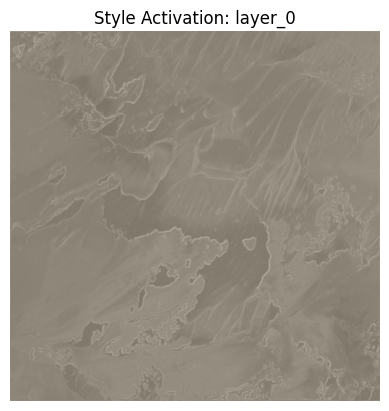

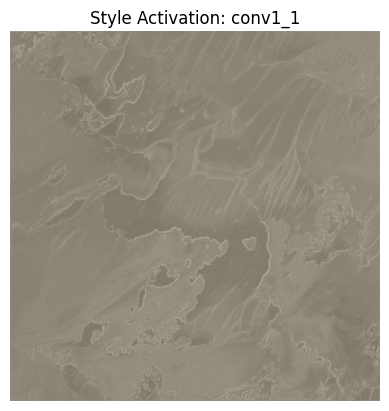

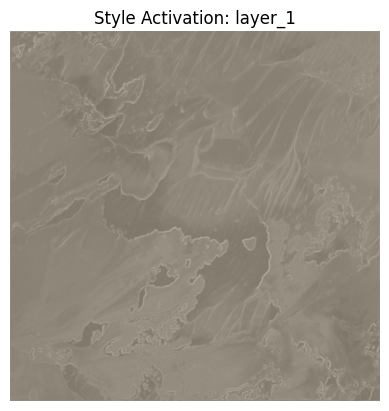

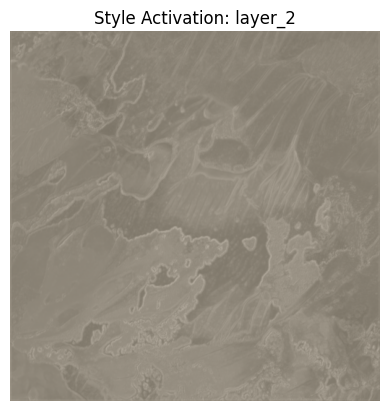

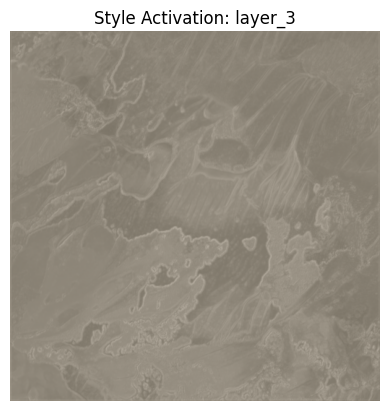

...

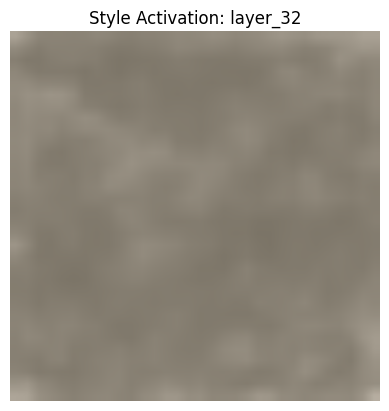

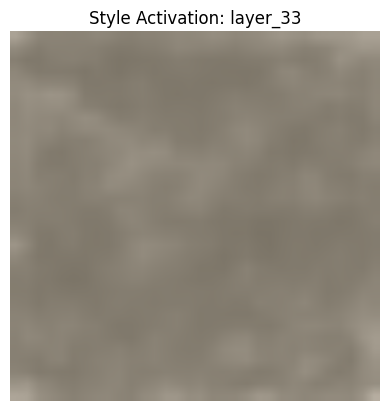

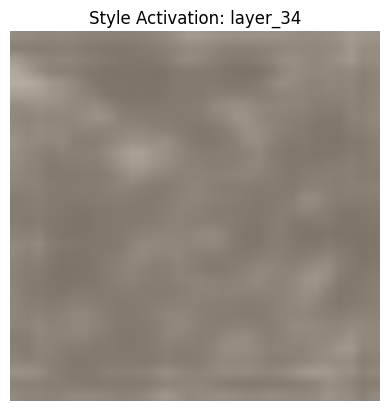

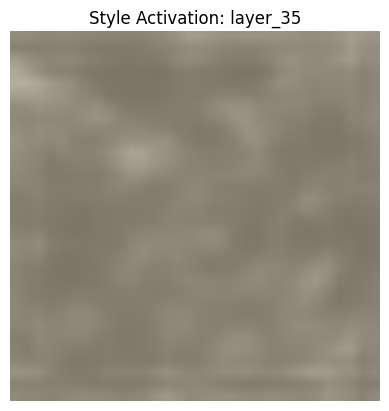

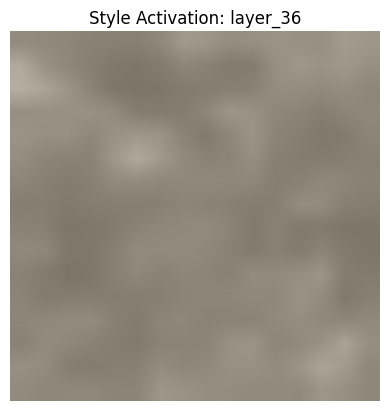

In [14]:
activations.clear()
with torch.no_grad():
    vgg(style_image)

visualize_activations(activations, 'Style')


In [18]:
def gram_matrix(tensor):
    c, h, w = tensor.size()
    features = tensor.view(c, h * w)
    G = torch.mm(features, features.t())
    return G / (c * h * w)


In [19]:
def visualize_gram_matrices(activations):
    for name, act in activations.items():
        G = gram_matrix(act.squeeze(0))  # [C, C]
        G_img = G.cpu().numpy()
        plt.figure(figsize=(5, 5))
        plt.imshow(G_img, cmap='viridis')
        plt.title(f'Gram Matrix: {name}')
        plt.axis('off')
        plt.show()


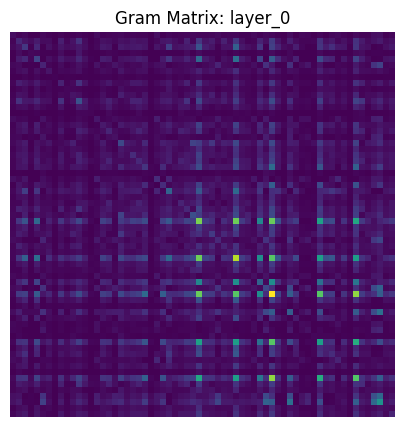

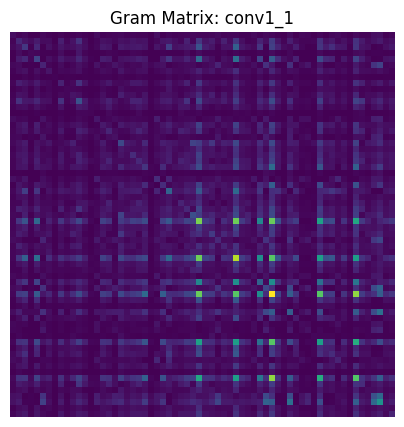

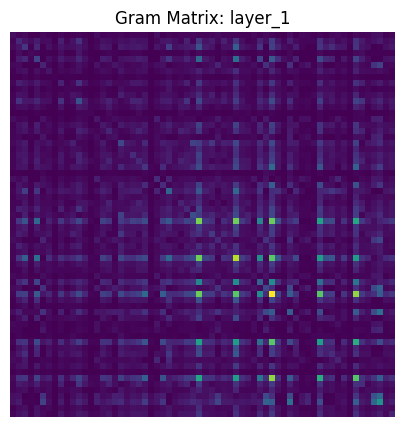

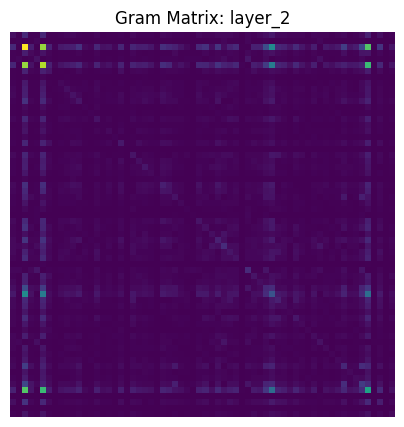

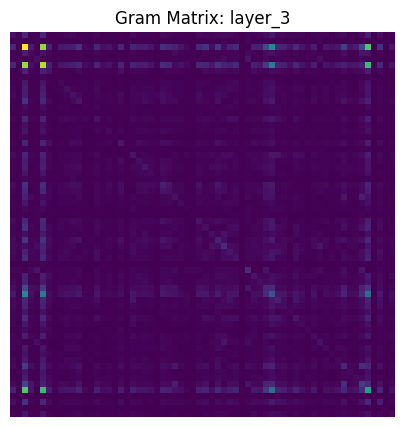

...

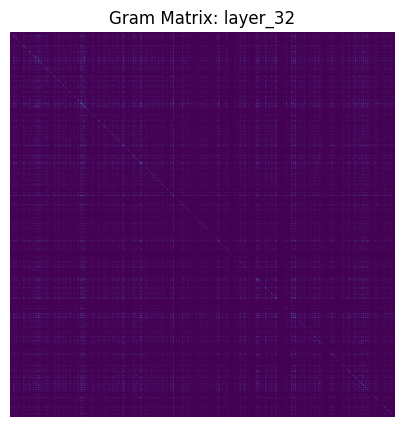

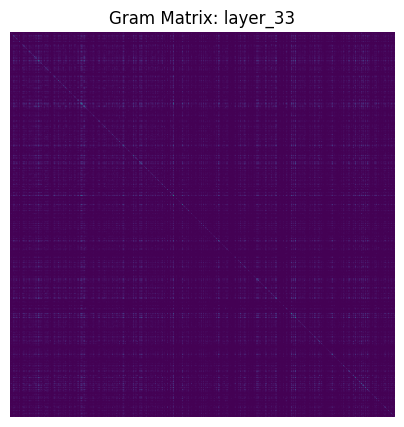

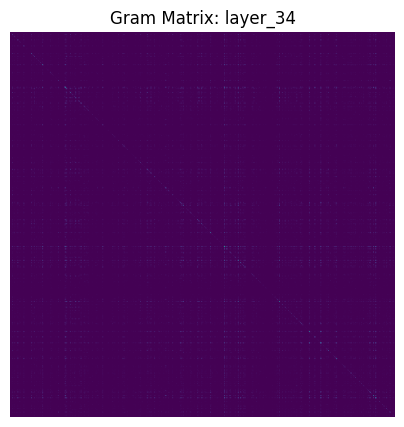

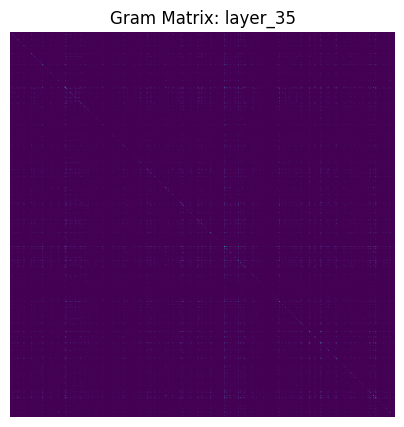

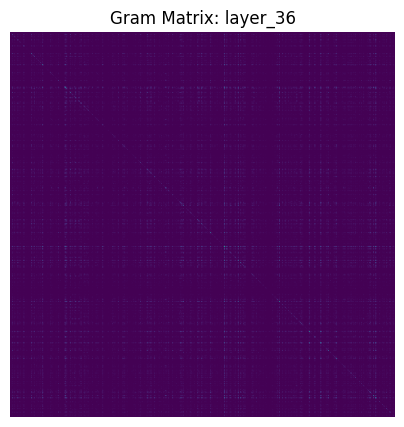

In [20]:
visualize_gram_matrices(activations)
